In [1]:
# load required package
import numpy as np
import os
import cv2

from matplotlib import pyplot as plt

import tensorflow as tf
from keras import backend as K

from tqdm import tqdm
from functools import partial
tqdm = partial(tqdm, position=0, leave=True)

In [2]:
# load self-defined functions
!cp /content/drive/MyDrive/Colab\ Notebooks/codes/modules/data_generator.py /content
!cp /content/drive/MyDrive/Colab\ Notebooks/codes/modules/dice.py /content
!cp /content/drive/MyDrive/Colab\ Notebooks/codes/modules/f1_score.py /content
!cp /content/drive/MyDrive/Colab\ Notebooks/codes/modules/misc.py /content
!cp /content/drive/MyDrive/Colab\ Notebooks/codes/modules/concatenate_split.py /content

from data_generator import binarize_mask, data_generator
from dice import dice_coef, dice_coef_loss
from f1_score import F1_score
from misc import convert_to_bw, plot_test_pred
from concatenate_split import concatenate_split

In [3]:
# define paths of the training, validation, and test sets
train_dir = '/content/drive/MyDrive/School/UPenn/Spring_2022/CPLN_680/sh_all_image_split/train/images/'
mask_dir = '/content/drive/MyDrive/School/UPenn/Spring_2022/CPLN_680/sh_all_mask_split/train/masks_xbuffer/'
 
val_dir = '/content/drive/MyDrive/School/UPenn/Spring_2022/CPLN_680/sh_all_image_split/val/images/'
v_mask_dir = '/content/drive/MyDrive/School/UPenn/Spring_2022/CPLN_680/sh_all_mask_split/val/masks_xbuffer/'

test_dir = '/content/drive/MyDrive/School/UPenn/Spring_2022/CPLN_680/sh_all_image_split/test/images/'
t_mask_dir = '/content/drive/MyDrive/School/UPenn/Spring_2022/CPLN_680/sh_all_mask_split/test/masks_xbuffer/'

In [4]:
# define the desired shape of images and their masks for training
image_shape = (256, 256)

In [5]:
# The following codes are adpoted and modified based on
# https://github.com/nikhilroxtomar/UNet-Segmentation-in-Keras-TensorFlow/blob/master/unet-segmentation.ipynb

# define the encoding path of a U-Net architecture
# batch normalization is used for speeding up the training
def down_block(x, filters, kernel_size=(3, 3), padding="same", strides=1):
    c = tf.keras.layers.Conv2D(filters, kernel_size, padding=padding, strides=strides, activation="relu")(x)
    c = tf.keras.layers.BatchNormalization()(c)
    c = tf.keras.layers.Conv2D(filters, kernel_size, padding=padding, strides=strides, activation="relu")(c)
    c = tf.keras.layers.BatchNormalization()(c)
    p = tf.keras.layers.MaxPool2D((2, 2), (2, 2))(c)
    return c, p

# define the decoding path of a U-Net architecture
def up_block(x, skip, filters, kernel_size=(3, 3), padding="same", strides=1):
    us = tf.keras.layers.Conv2DTranspose(filters, kernel_size = (2, 2), strides = (2, 2))(x)
    concat = tf.keras.layers.Concatenate()([us, skip])
    c = tf.keras.layers.Conv2D(filters, kernel_size, padding=padding, strides=strides, activation="relu")(concat)
    c = tf.keras.layers.BatchNormalization()(c)
    c = tf.keras.layers.Conv2D(filters, kernel_size, padding=padding, strides=strides, activation="relu")(c)
    c = tf.keras.layers.BatchNormalization()(c)
    return c

# define the bridge of a U-Net architecture
def bottleneck(x, filters, kernel_size=(3, 3), padding="same", strides=1):
    c = tf.keras.layers.Conv2D(filters, kernel_size, padding=padding, strides=strides, activation="relu")(x)
    c = tf.keras.layers.BatchNormalization()(c)
    c = tf.keras.layers.Conv2D(filters, kernel_size, padding=padding, strides=strides, activation="relu")(c)
    c = tf.keras.layers.BatchNormalization()(c)
    return c

# define a U-Net starting with 64 filters and down to 1024 filters at the bridge
# the input of training data is (256, 256) with RGB channels
def UNet():
    f = [64, 128, 256, 512, 1024]
    inputs = tf.keras.layers.Input((256, 256, 3))
    
    p0 = inputs
    c1, p1 = down_block(p0, f[0]) 
    c2, p2 = down_block(p1, f[1]) 
    c3, p3 = down_block(p2, f[2]) 
    c4, p4 = down_block(p3, f[3]) 
    
    bn = bottleneck(p4, f[4])
    
    u1 = up_block(bn, c4, f[3])
    u2 = up_block(u1, c3, f[2])
    u3 = up_block(u2, c2, f[1])
    u4 = up_block(u3, c1, f[0])
    
    outputs = tf.keras.layers.Conv2D(1, (3, 3), padding="same", activation="sigmoid")(u4)
    model = tf.keras.models.Model(inputs, outputs)

    model = tf.keras.models.Model(inputs=inputs, outputs=outputs)
    # the learning rate is set to 0.0001
    adam = tf.keras.optimizers.Adam(learning_rate=0.0001)
    # compile the model with dice loss
    model.compile(optimizer=adam,
                  loss=dice_coef_loss,
                  metrics=[dice_coef])
    return model

In [6]:
# get the model summary
model = UNet()
model.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d (Conv2D)                (None, 256, 256, 64  1792        ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 batch_normalization (BatchNorm  (None, 256, 256, 64  256        ['conv2d[0][0]']                 
 alization)                     )                                                           

In [ ]:
# feed the model with 2 images and their masks for preventing out-of-memory error
batch_size = 2

# the steps in each epoch will be the number of total images divided by the batch size
n_step = len(os.listdir(train_dir)) // batch_size

# fit the model
history = model.fit(data_generator(train_dir, mask_dir, batch_size, image_shape),
                    steps_per_epoch=n_step,
                    epochs=12,
                    verbose=1,
                    validation_data=data_generator(val_dir, v_mask_dir, batch_size, image_shape),
                    validation_steps=1)

Epoch 1/12


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  if sys.path[0] == '':


1425/1425 [==============================] - 944s 659ms/step - loss: 0.6351 - dice_coef: 0.3649 - val_loss: 0.9700 - val_dice_coef: 0.0300
Epoch 2/12
1425/1425 [==============================] - 112s 79ms/step - loss: 0.5824 - dice_coef: 0.4176 - val_loss: 0.8605 - val_dice_coef: 0.1395
Epoch 3/12
1425/1425 [==============================] - 112s 78ms/step - loss: 0.5475 - dice_coef: 0.4525 - val_loss: 0.5360 - val_dice_coef: 0.4640
Epoch 4/12
1425/1425 [==============================] - 112s 78ms/step - loss: 0.5189 - dice_coef: 0.4811 - val_loss: 0.7130 - val_dice_coef: 0.2870
Epoch 5/12
1425/1425 [==============================] - 112s 78ms/step - loss: 0.4976 - dice_coef: 0.5024 - val_loss: 0.9999 - val_dice_coef: 5.0678e-05
Epoch 6/12
1425/1425 [==============================] - 112s 79ms/step - loss: 0.4753 - dice_coef: 0.5247 - val_loss: 0.3132 - val_dice_coef: 0.6868
Epoch 7/12
1425/1425 [==============================] - 214s 151ms/step - loss: 0.4620 - dice_coef: 0.5380 - val

In [ ]:
# save the model aftering training
# model.save('/content/drive/MyDrive/School/UPenn/Spring_2022/CPLN_680/models_saved/0421_VUNet_S1')

INFO:tensorflow:Assets written to: /content/drive/MyDrive/School/UPenn/Spring_2022/CPLN_680/DigitalSreeniExample/models_saved/0421_VUNet_S1/assets


In [7]:
# load the model from the save files
model = tf.keras.models.load_model('/content/drive/MyDrive/School/UPenn/Spring_2022/CPLN_680/models_saved/0421_VUNet_S1', custom_objects={"dice_coef_loss": dice_coef_loss, "dice_coef": dice_coef})

In [8]:
# derive prediction of the test set
batch_size = 25
n_step = len(os.listdir(test_dir)) // batch_size
pred = model.predict(data_generator(test_dir, t_mask_dir, batch_size, image_shape), verbose = 1, steps = n_step)

61/61 [==============================] - 366s 6s/step


In [9]:
# get the number of whole images
split_num = len(os.listdir(test_dir))
test_num = split_num // 25

In [10]:
# load concatenated test images
concatImg = concatenate_split(test_dir, test_num, mask = False, prediction = None)

loading split images


100%|██████████| 1525/1525 [00:07<00:00, 206.11it/s]


Concatenating...


100%|██████████| 61/61 [00:00<00:00, 366.44it/s]


In [11]:
# load concatenated test masks
concatMask = concatenate_split(test_dir, test_num, mask = True, prediction = None)

loading split images


100%|██████████| 1525/1525 [00:04<00:00, 330.97it/s]


Concatenating...


100%|██████████| 61/61 [00:00<00:00, 338.21it/s]


In [12]:
# load concatenated prediction
concatPred = concatenate_split(test_dir, test_num, mask = True, prediction = pred)

loading predictions
Concatenating...


100%|██████████| 61/61 [00:00<00:00, 285.52it/s]


In [13]:
# convert the prediction to black and white image
concatPred = convert_to_bw(concatPred, test_num)

100%|██████████| 61/61 [03:16<00:00,  3.22s/it]


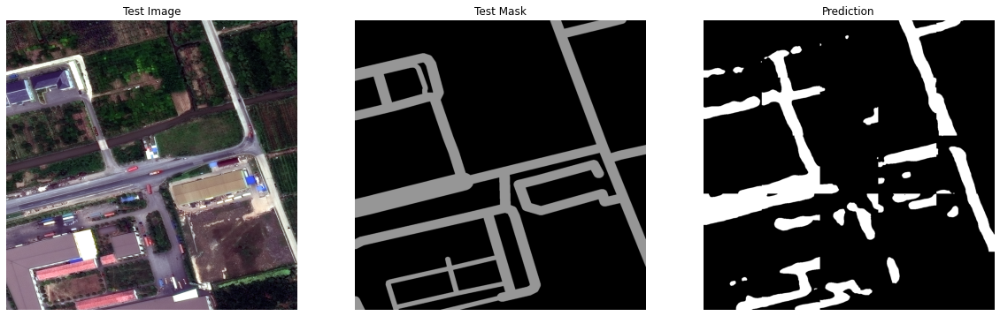

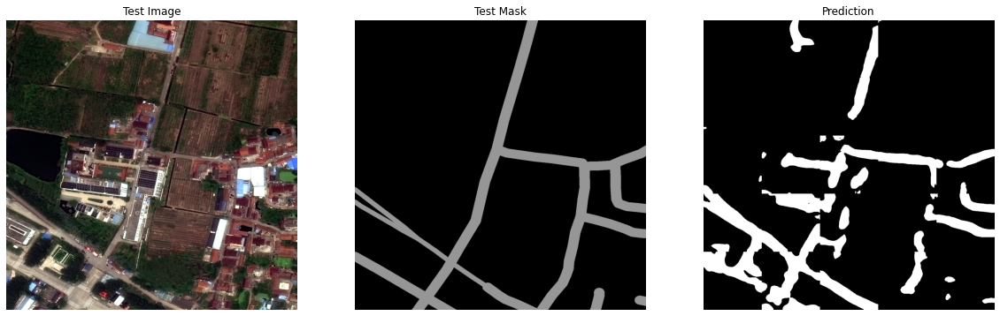

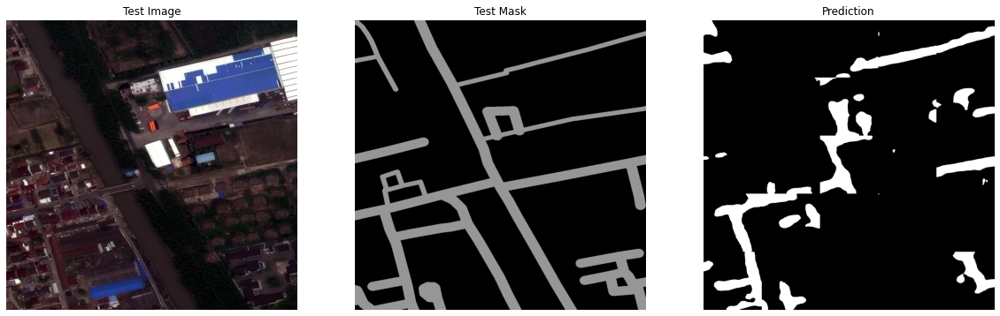

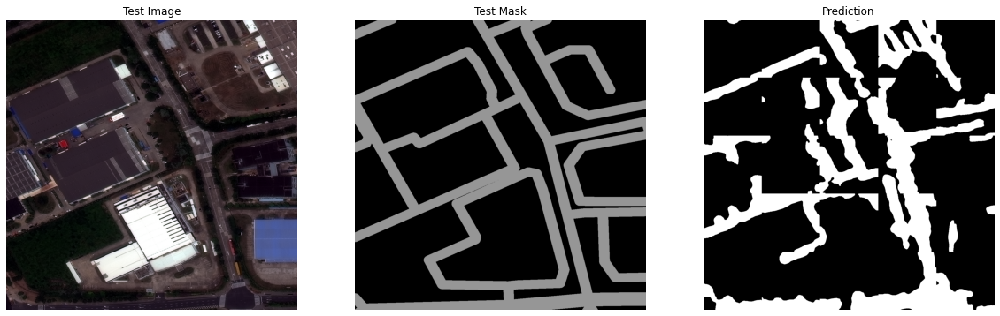

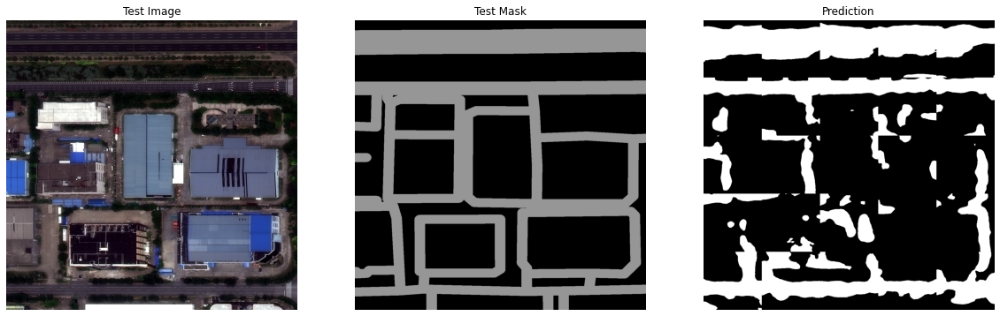

...

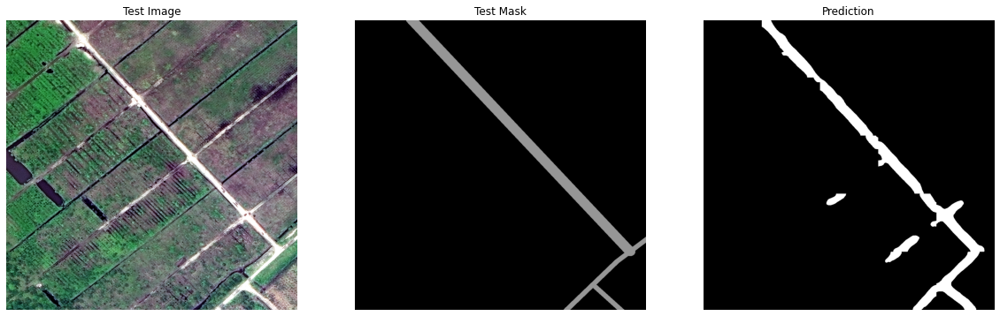

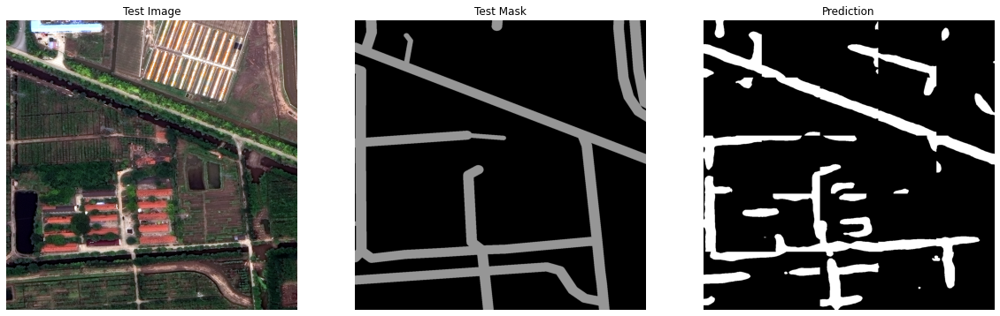

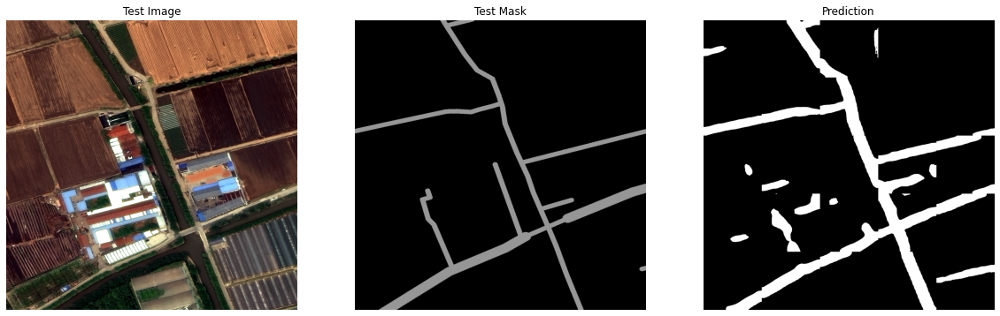

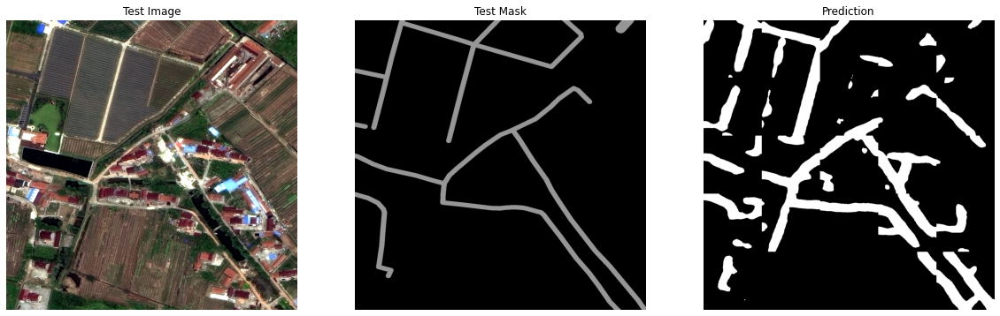

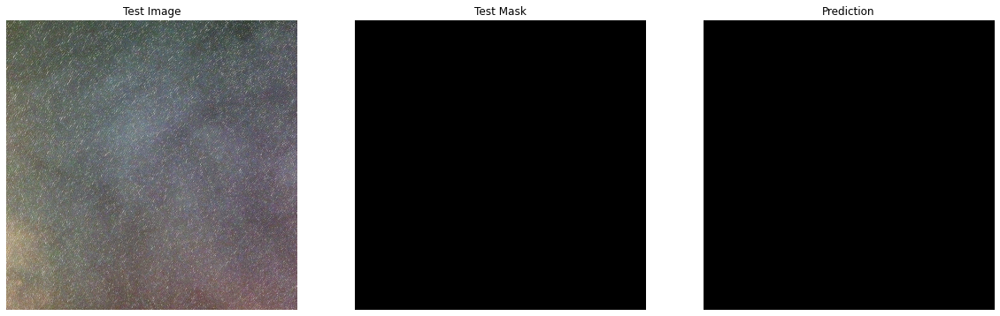

In [14]:
plot_test_pred(concatImg, concatMask, concatPred, test_num)

In [15]:
F1_score(concatMask, concatPred)

0.6268918095080941